In [5]:
%load_ext autoreload
%autoreload 2
import rasterio
import os
import numpy as np
import matplotlib.pyplot as plt
from tqdm import tqdm
from scipy.stats import pearsonr
import pandas as pd
import random
import torch
import shutil
from IPython.display import clear_output
import utilities
from unet import UNet

In [6]:
# paths
image_folder = "dataset/data"
mask_folder = "dataset/masks"

In [7]:
# File lists
image_files = sorted([f for f in os.listdir(image_folder)])
mask_files = sorted([f for f in os.listdir(mask_folder)])
assert len(image_files) == len(mask_files), "bro?"
print(len(image_files))

10573


### EDA

Let's load some random samples from our dataset to understand it.

In [8]:
def display_image_and_mask(image_path, mask_path):
    with rasterio.open(image_path) as src:
        image = src.read()  # shape: (C, H, W)
    
    with rasterio.open(mask_path) as msk:
        mask = msk.read(1)
        mask[0][0]= 0 # for visualization

    R, G, B, IR = image[0], image[1], image[2], image[3]
    RGB = np.stack([R, G, B], axis=-1)
    RGB = np.clip(RGB / RGB.max(), 0, 1)  # Normalize for visualization

    plt.ion()

    fig, axes = plt.subplots(1, 6, figsize=(18, 4))
    titles = ['Red', 'Green', 'Blue', 'Infrared', 'RGB', 'Mask']
    images = [R, G, B, IR, RGB, mask]

    for ax, img, title in zip(axes, images, titles):
        ax.imshow(img, cmap='gray' if title != 'RGB' else None)
        ax.set_title(title)
        ax.axis('off')

    plt.tight_layout()
    plt.pause(0.001) 
    return fig

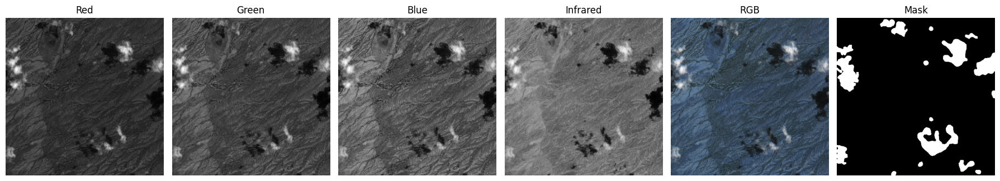

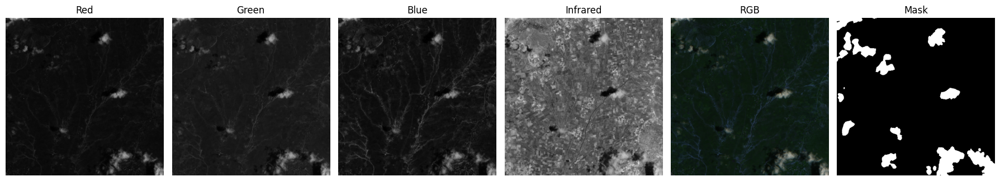

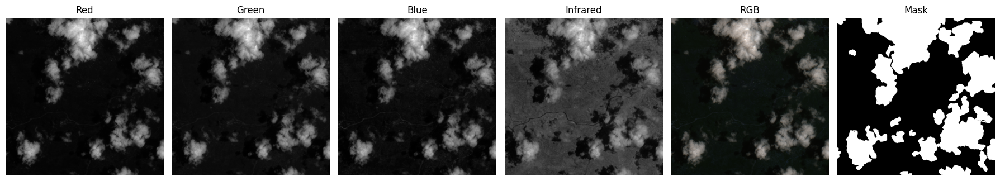

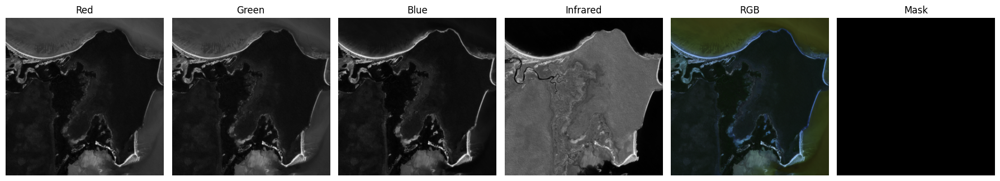

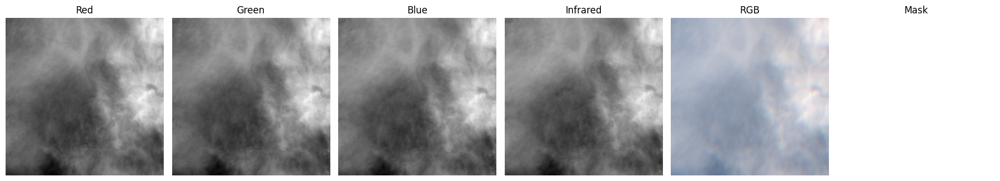

...

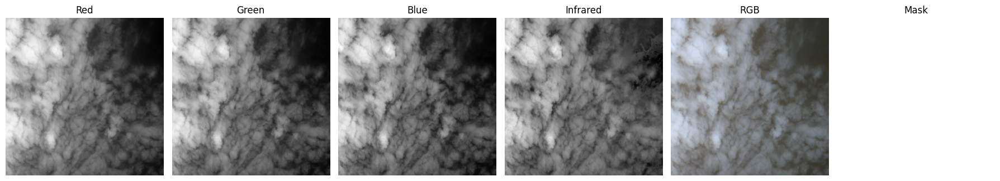

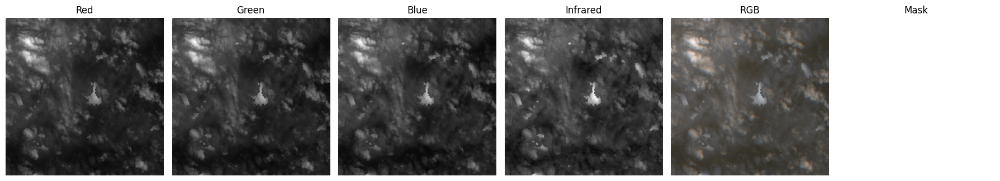

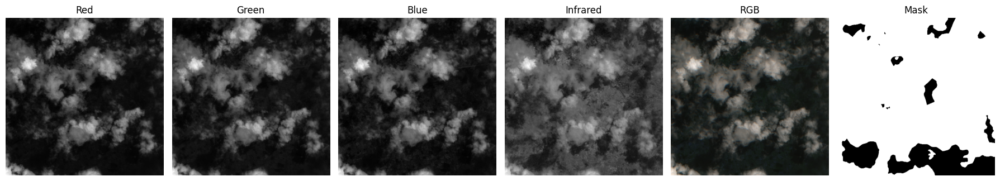

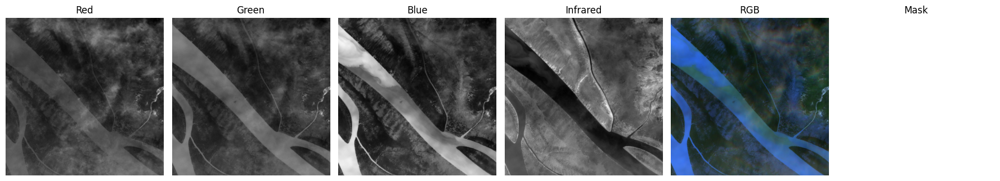

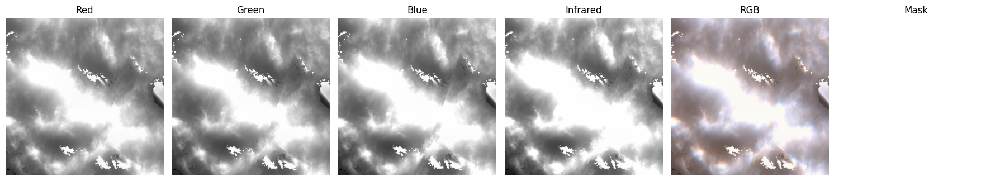

In [10]:
# Randomly sample 50 image filenames
sampled_files = random.sample(image_files, 50)

for fname in sampled_files:
    image_path = os.path.join(image_folder, fname)
    mask_path = os.path.join(mask_folder, fname) 

    try:
        display_image_and_mask(image_path, mask_path)
    except Exception as e:
        print(f"Error loading {fname}: {e}")

We can see that some images have wrong masks (mask doesn't really represent clouds in image or is just random).  
And there are missing values (mask is completely black although there are clouds in image).  

Let's load the whole dataset and make a summary of all information that is or could be useful, then investigate further.  

NOTE: skip this if dataset_summary.csv already exists (for the sake of saving time)

In [24]:
data_summary = []

for img_file, mask_file in tqdm(zip(image_files, mask_files), total=len(image_files)):
    image_path = os.path.join(image_folder, img_file)
    mask_path = os.path.join(mask_folder, mask_file)

    try:
        # Load image
        with rasterio.open(image_path) as src:
            img = src.read().astype(np.float32)  # shape: (bands, H, W)
            img_shape = (src.height, src.width)
            bands = src.count

            flat_bands = img.reshape(bands, -1)
            red, green, blue, ir = flat_bands
            corr_red_ir = pearsonr(red, ir)[0]
            corr_green_ir = pearsonr(green, ir)[0]
            corr_blue_ir = pearsonr(blue, ir)[0]
            # Compute mean and std per channel (assumes 4 bands: RGB + IR)
            means = img.reshape(bands, -1).mean(axis=1)
            stds = img.reshape(bands, -1).std(axis=1)

        # Load mask
        with rasterio.open(mask_path) as msk_src:
            mask = msk_src.read(1)
            total_pixels = mask.size
            cloud_pixels = np.count_nonzero(mask)
            cloud_coverage = cloud_pixels / total_pixels

        # Add record
        data_summary.append({
            "image_file": img_file,
            "mask_file": mask_file,
            "shape": (img_shape[0], img_shape[1], bands),
            "cloud_coverage": round(cloud_coverage, 4),
            "mean_red": round(means[0], 2),
            "mean_green": round(means[1], 2),
            "mean_blue": round(means[2], 2),
            "mean_ir": round(means[3], 2),
            "std_red": round(stds[0], 2),
            "std_green": round(stds[1], 2),
            "std_blue": round(stds[2], 2),
            "std_ir": round(stds[3], 2),
            "corr_red_ir": round(corr_red_ir, 4),
            "corr_green_ir": round(corr_green_ir, 4),
            "corr_blue_ir": round(corr_blue_ir, 4),
        })

    except Exception as e:
        print(f"Error processing {img_file} or {mask_file}: {e}")

# Save to CSV
df = pd.DataFrame(data_summary)
df.to_csv("dataset_summary.csv", index=False)
print("✅ Saved dataset_summary.csv")

100%|██████████| 10573/10573 [21:42<00:00,  8.12it/s]


✅ Saved dataset_summary.csv


In [9]:
df = pd.read_csv('dataset_summary.csv')

In [10]:
print(df['shape'].unique())

['(512, 512, 4)']


All images have the same shape and has 4 bands, so there are no corrupted images.

Fully Clouded: 2730 | Partially Clouded: 7142 | Cloud-Free: 701 | Total: 10573


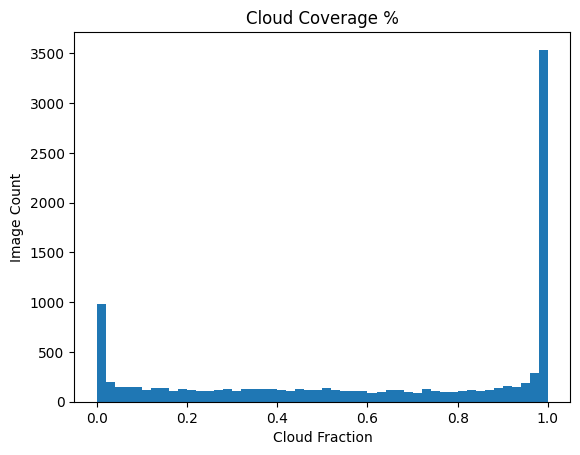

In [11]:
cloud_coverage = df['cloud_coverage']
cloud_free =  df[cloud_coverage == 0]['image_file'].tolist()
partially_clouded =  df[(cloud_coverage < 1) & (cloud_coverage > 0)]['image_file'].tolist()
fully_clouded =  df[cloud_coverage == 1]['image_file'].tolist()
total = len(fully_clouded) + len(partially_clouded) + len(cloud_free)
print(f"Fully Clouded: {len(fully_clouded)} | Partially Clouded: {len(partially_clouded)} | Cloud-Free: {len(cloud_free)} | Total: {total}")

plt.hist(cloud_coverage, bins=50)
plt.title("Cloud Coverage %")
plt.xlabel("Cloud Fraction")
plt.ylabel("Image Count")
plt.show()

Dataset has:
- 2730 Fully clouded images (or mask is wrong)
- 701 Cloud-free images (or mask is missing)
- 7142 Partially clouded images (or mask is wrong)

We need to handle those with wrong or missing masks, so we'll try the following approach:
1) Manually selecting a clean subset of data (with correct masks)
2) Training a UNet model on them (UNet is known for performing good on small data)
    - if we didn't get results that are good enough, repeat step 1 
3) Predicting masks on the whole dataset and flag bad masks for reviewing
4) Drop noise data with bad masks or replace it with model output

### Preprocessing

#### STEP 1: Manually selecting a clean subset of data

In [12]:
def review_and_clean(
        image_files,
        img_dir='dataset/data',
        mask_dir='dataset/masks',
        clean_data_dir='inputs/reviewed/data',
        clean_mask_dir='inputs/reviewed/masks',
        noise_data_dir='noise/data',
        noise_mask_dir='noise/masks',
        missing_data_dir='missing/data',
        missing_mask_dir='missing/masks'
    ):
    
    for fname in image_files:
        if os.path.exists(os.path.join(clean_data_dir, fname)):
            #print(f"Already reviewed (clean): {fname} — Skipping.")
            continue
        if os.path.exists(os.path.join(noise_data_dir, fname)):
            #print(f"Already reviewed (noise): {fname} — Skipping.")
            continue
        if os.path.exists(os.path.join(missing_data_dir, fname)):
        #print(f"Already reviewed (clean): {fname} — Skipping.")
            continue

        img_path = os.path.join(img_dir, fname)
        mask_path = os.path.join(mask_dir, fname)

        if not os.path.exists(img_path) or not os.path.exists(mask_path):
            print(f"Missing file(s) for: {fname} — Skipping.")
            continue

        print(f"Reviewing: {fname}")
        fig = display_image_and_mask(img_path, mask_path)

        action = input("Mark as clean? [y = yes, n = no, m = missing, q = quit]: ").strip().lower()
        plt.close(fig) 
        clear_output(wait=True)
        
        if action == 'y':
            shutil.copy(img_path, os.path.join(clean_data_dir, fname))
            shutil.copy(mask_path, os.path.join(clean_mask_dir, fname))
            print("Saved to clean dataset.")
        elif action == 'n':
            shutil.copy(img_path, os.path.join(noise_data_dir, fname))
            shutil.copy(mask_path, os.path.join(noise_mask_dir, fname))
            print("Saved to noise dataset.")
        elif action == 'm':
            shutil.copy(img_path, os.path.join(missing_data_dir, fname))
            shutil.copy(mask_path, os.path.join(missing_mask_dir, fname))
            print("Saved to missing dataset.")
        elif action == 'q':
            print("Exiting review loop.")
            break
        else:
            print("Skipped without saving.")
        

In [13]:
review_and_clean(fully_clouded)

Exiting review loop.


In [119]:
review_and_clean(partially_clouded)

Exiting review loop.


In [141]:
review_and_clean(cloud_free)

Exiting review loop.


In [15]:
# Save file names in a text file to load them easily on cloud
def save_filenames_to_txt(directory_path, output_file):
    filenames = os.listdir(directory_path)
    
    with open(output_file, 'w') as f:
        for name in filenames:
            f.write(name + '\n')

In [36]:
save_filenames_to_txt('inputs/reviewed/data', 'cloud/reviewed.txt')
save_filenames_to_txt('noise/data', 'cloud/noise.txt')
save_filenames_to_txt('missing/data', 'cloud/missing.txt')

fc = 0
cf = 0
pc= 0
for f in os.listdir('inputs/reviewed/data'):
    cloud_coverage = df[df['image_file'] == f]['cloud_coverage'].values[0] 
    if cloud_coverage == 1:
        fc += 1
    elif cloud_coverage == 0:
        cf += 1
    else:
        pc += 1

print(f"Fully Clouded: {fc} | Partially Clouded: {pc} | Cloud-Free: {cf}")
print("Reviewed: ", len([f for f in os.listdir('inputs/reviewed/data')]))

Fully Clouded: 167 | Partially Clouded: 524 | Cloud-Free: 159
Reviewed:  850


#### STEP 2: Training a UNet model

In [ ]:
model = UNet()
utilities.run(model, lr=1e-3, input_dir='inputs/reviewed', num_epochs=1)

Train: 593 | Val: 126 | Test: 131


Best threshold: 0.29 with loss: 0.3580 with Dice: 0.6970
Train Loss: 0.4236 | Val Dice: 0.6970
Best val dice: 0.6970, Best Threshold: 0.29


Best threshold: 0.29 with loss: 0.3846 with Dice: 0.6593


The following cell was ran on kaggle with different hyperparameters to save time  
and selected hyperparameters are shown below

In [ ]:
model = UNet()
utilities.run(model, lr=1e-3, input_dir='inputs/reviewed', num_epochs=30, patience=10, gamma=0.5, batch_size=8)

In [25]:
model = UNet()
model.load_state_dict(torch.load('models/simple_unet.pkl'))

C:\Users\Dell\AppData\Local\Temp\ipykernel_11804\749474100.py:2: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load('models/simple_unet.pkl'))


<All keys matched successfully>

In [26]:
torch.save(model, 'models/whole_simple_unet_model.pkl')

Let's see how our simple UNet model performs and repeat step 1 until we get results that are good enough

Match: 100.00


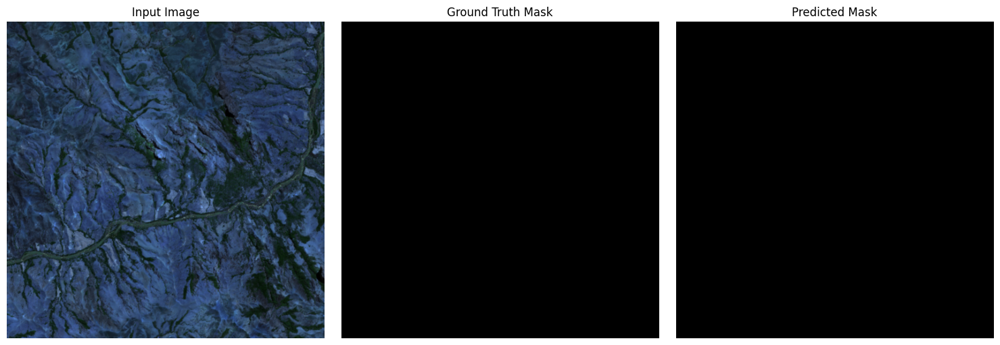

Match: 98.37


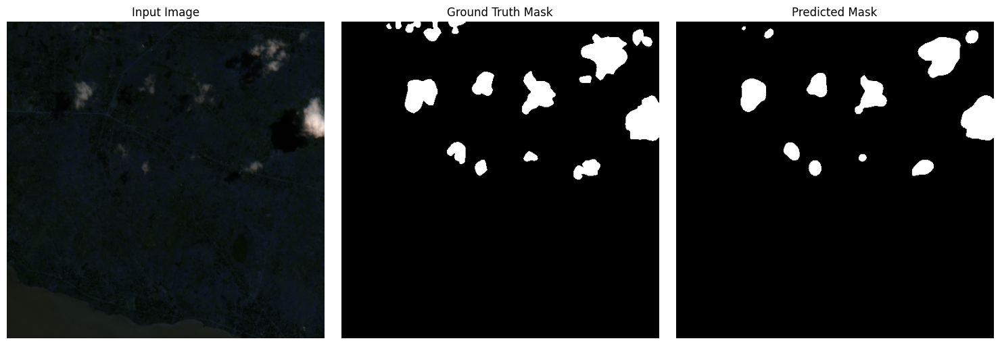

Match: 95.83


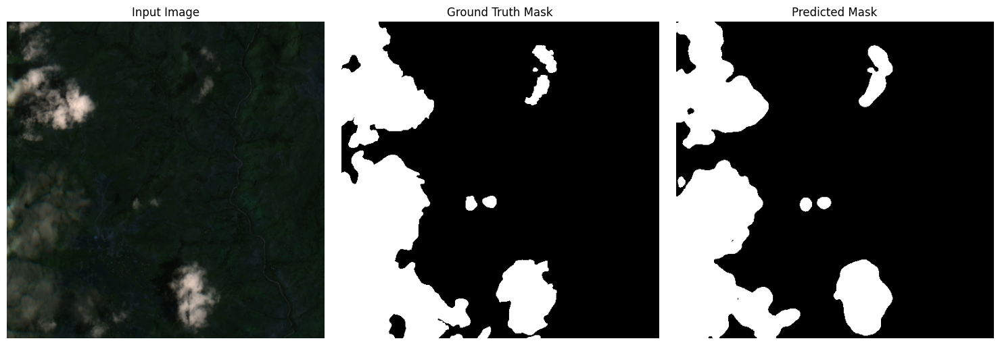

Match: 99.21


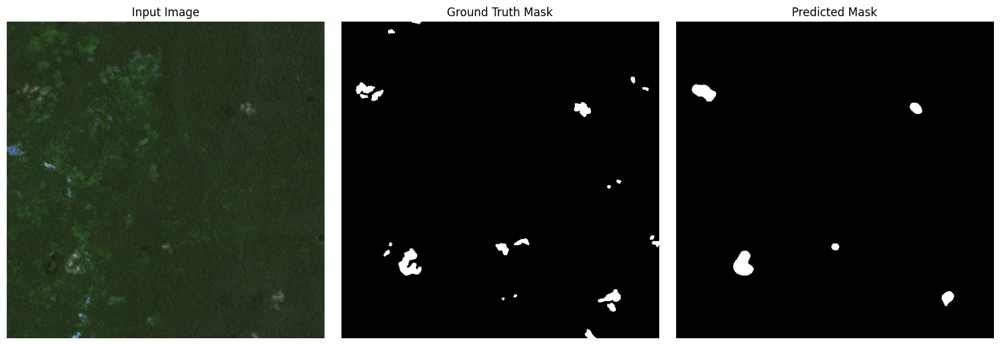

Match: 94.20


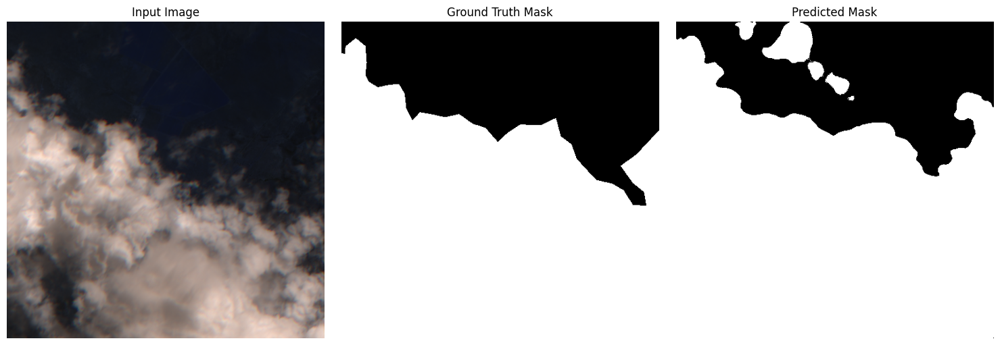

Match: 93.50


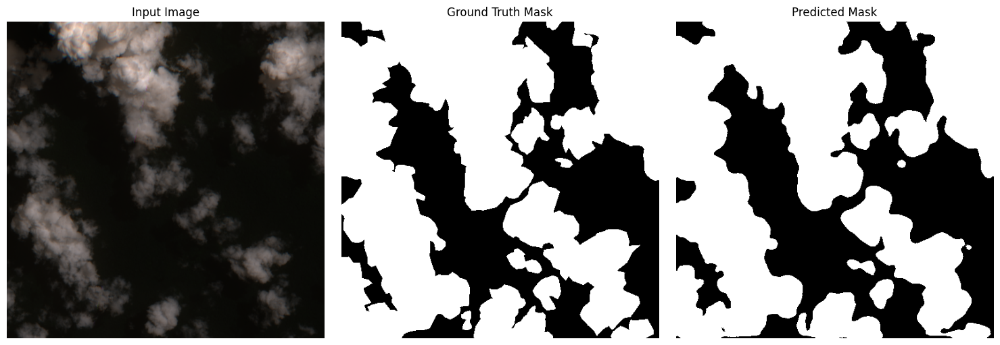

Match: 93.63


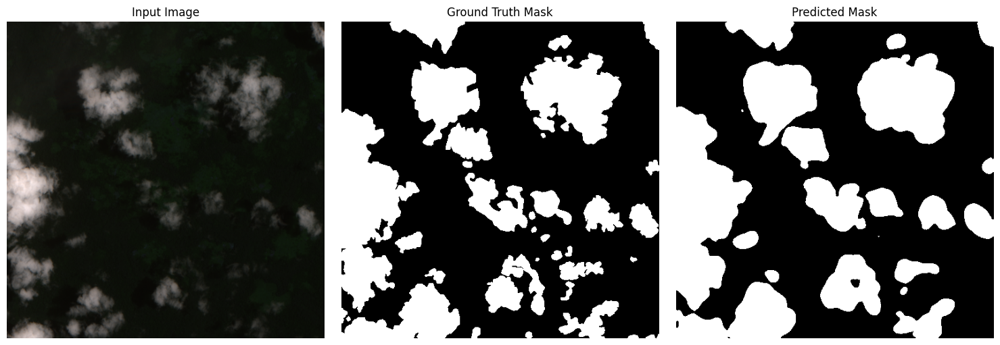

Match: 100.00


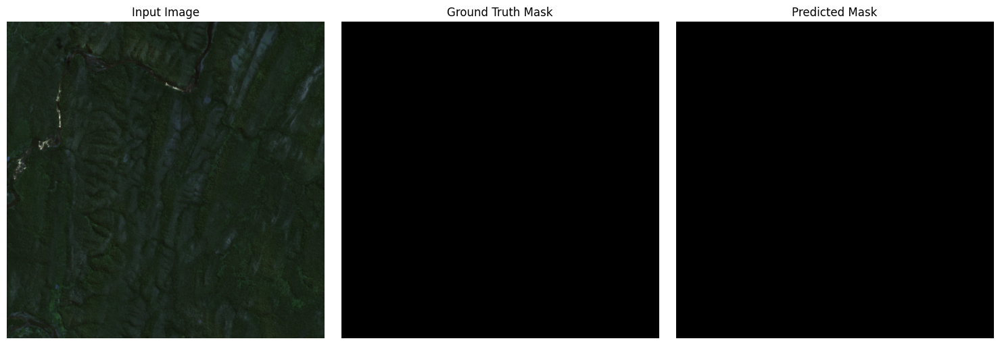

Match: 99.36


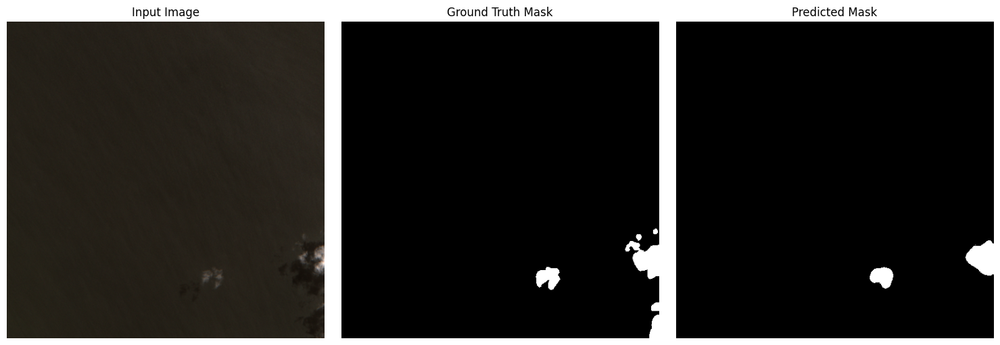

Match: 90.13


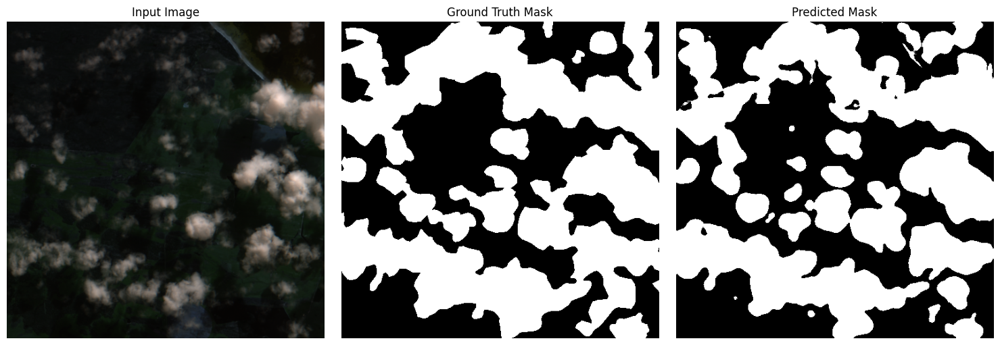

In [ ]:
dir = 'dataset'
data_files = [f for f in os.listdir(dir + '/data')]
with open("thresholds/simple_unet_best_threshold.txt", "r") as f:
    best_threshold = float(f.read())

for f in data_files[:10]:
    utilities.predict_one(model, dir + '/data/' + f, dir + '/masks/' + f, threshold=best_threshold, visualize=True)

#### STEP 3: Predicting masks on the whole dataset and flag bad masks for reviewing

Clean data (that has mask close to model output) is copied to `cleaned` folder and noise data is copied to `noise` folder

In [ ]:
utilities.predict_and_clean(model, input_dir='dataset', best_threshold=best_threshold, confidence=84)

Predicting: 100%|██████████| 10573/10573 [1:02:26<00:00,  2.82it/s]

Average Percentage Match on Test Set: 90.82%


Repeat step 3 with a more strict confidence value till we flag a reasonable amount of noise

In [21]:
print(len([f for f in os.listdir('noise/data')]))

1397


#### STEP 4: Drop noise data or replace it with model output

We can either just ignore noise data and train on the rest, or replace these bad masks with the model output and train on the whole dataset.  
We'll try both when developing the model and see how it goes.

In [ ]:
# Replace bad masks with model output
utilities.predict_and_clean(model, input_dir='noise', best_threshold=best_threshold, replace=True, visualize=False)

Predicting: 100%|██████████| 1397/1397 [09:47<00:00,  2.38it/s]

Average Percentage Match on Test Set: 55.42%


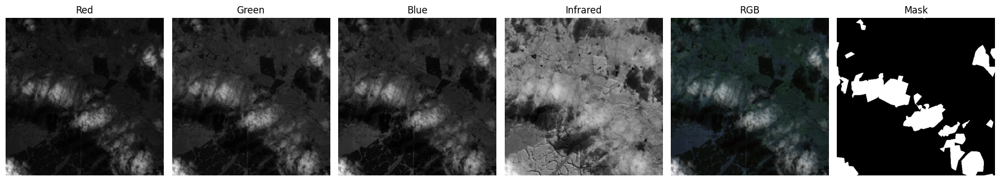

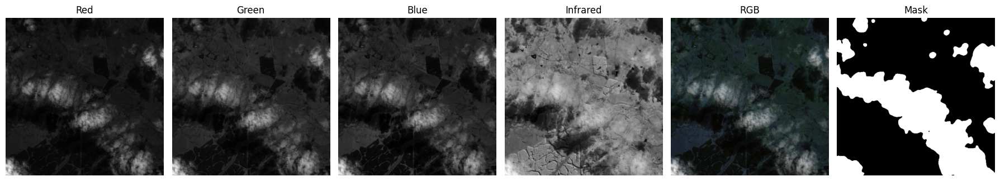

In [ ]:
# Sample noise vs model output
noise = [f for f in os.listdir('noise/data')]
for f in noise[5:6]:
    display_image_and_mask('noise/data/' + f, 'noise/masks/' + f)
    display_image_and_mask('inputs/processed/data/' + f, 'inputs/processed/masks/' + f)

In [ ]:
# save file names to use on cloud
save_filenames_to_txt('inputs/processed/data', 'cloud/processed.txt')
save_filenames_to_txt('inputs/cleaned/data', 'cloud/cleaned.txt')
save_filenames_to_txt('inputs/missing/data', 'cloud/missing.txt')
save_filenames_to_txt('inputs/noise/data', 'cloud/noise.txt')
save_filenames_to_txt('inputs/reviewed/data', 'cloud/reviewed.txt')